# Script to aquire and pre-process all data for the model

Very useful packages:
- https://samgeo.gishub.org/installation/ to convert TMS to GeoTIFF and  also to segment satellite images in general
- https://gdal.org/en/stable/programs/gdal_translate.html to convert geodata formats 
- https://rasterio.readthedocs.io/en/stable/ to rasterize OSM vector data or to visualize a raster
- https://osmnx.readthedocs.io/en/stable/ to easily download OSM data
- https://geopandas.org/en/stable/ to handle vector data
- https://docs.xarray.dev/en/stable/ for cube handling of raster data

In [10]:
## Import libraries
# system
import os
import sys
import time
import io
import requests
import multiprocessing as mp
sys.path.append("/usr/share/lmod/lmod/init")
from env_modules_python import module

# loading cluster modules
gdal_root = "/software/easybuild/el8/amd_zen3/all/GDAL/3.9.0-foss-2023b"
cuda_root = "/software/easybuild/el8/amd_zen3/all/CUDA/12.6.0"

module("load", "CUDA")
module("load", "GDAL")

os.environ["PATH"] = f"{cuda_root}/bin:{os.environ['PATH']}"
os.environ["LD_LIBRARY_PATH"] = f"{cuda_root}/lib:{os.environ.get('LD_LIBRARY_PATH', '')}"
os.environ["CUDA_HOME"] = cuda_root
os.environ["CUDA_PATH"] = cuda_root
import torch
print("CUDA is available: ", torch.cuda.is_available()) # Test CUDA

# GDAL setup with corrected paths
os.environ["PATH"] = f"{gdal_root}/bin:{os.environ['PATH']}"
os.environ["LD_LIBRARY_PATH"] = f"{gdal_root}/lib64:{gdal_root}/lib:{os.environ.get('LD_LIBRARY_PATH', '')}"
os.environ["GDAL_DATA"] = f"{gdal_root}/share/gdal"
os.environ["GDAL_DRIVER_PATH"] = f"{gdal_root}/lib64/gdalplugins"
print("GDAL is available: ", os.system("gdalinfo --version")) # Test GDAL

# os.environ["PATH"] = f"{gdal_root}/bin:" + os.environ["PATH"]
# os.environ["LD_LIBRARY_PATH"] = f"{gdal_root}/lib:" + os.environ.get("LD_LIBRARY_PATH", "")
# os.environ["GDAL_DATA"] = f"{gdal_root}/share/gdal"
# os.environ["GDAL_DRIVER_PATH"] = f"{gdal_root}/lib/gdalplugins"


# data manipulation
from PIL import Image
import numpy as np
import pandas as pd
import geopandas as gpd
import osmnx as ox
import rasterio as rio
from rasterio.transform import from_bounds
from rasterio.features import geometry_mask, rasterize
from pyproj import Transformer, CRS
from shapely.geometry import box
from samgeo import tms_to_geotiff

# visualization
from rasterio.plot import show
import leafmap
from ipyleaflet import Map, WMSLayer, basemaps, TileLayer, DrawControl, FullScreenControl, LayersControl, MeasureControl, SplitMapControl, WidgetControl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib as mpl

CUDA is available:  True
GDAL 3.9.0, released 2024/05/07
GDAL is available:  0


### Stadt Leipzig Orthophoto (WMS)

The city of Leipzig created orthophotos of the city in spring 2022: https://www.leipzig.de/bauen-und-wohnen/bauen/geodaten-und-karten/luftbilder-und-orthophotos

The photos are available as a WMS layer under: https://geodienste.leipzig.de/l4/Luftbild_2022/service?request=getCapabilities


In [2]:
# leipzig center
center = [51.340632, 12.374732]
zoom = 13
m = leafmap.Map(center=center, zoom=zoom)
m

Map(center=[51.340632, 12.374732], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…

In [4]:
m.user_roi_bounds()

[12.3735, 51.324, 12.3935, 51.3321]

In [3]:
# leipzig center
center = [51.340632, 12.374732]
zoom = 13
m = Map(basemap=basemaps.CartoDB.Positron, center=center, zoom=zoom)

#add layer control
m.add_control(LayersControl())
m.add_control(DrawControl())

m

Map(center=[51.340632, 12.374732], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…

In [4]:
wms = WMSLayer(
    url='https://geodienste.leipzig.de/l4/Luftbild_2022/service',
    layers='Luftbild_2022',
    name='Luftbild 2022',
    format='image/png',
    transparent=True,
    attribution='Stadt Leipzig',
)
m.add_layer(wms)

In [5]:
source_url_google = 'https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}'

In [6]:
google_tiles = TileLayer(url=source_url_google, name='Google Satellite')
m.add_layer(google_tiles)

In [18]:
bounds = [12.3449, 51.3383, 12.3665, 51.3479] #[12.3452, 51.3409, 12.3593, 51.3472] #m.user_roi_bounds()
bounds

[12.3449, 51.3383, 12.3665, 51.3479]

In [8]:
tms_to_geotiff(bbox=bounds, output='google_satellite.tif', source=source_url_google, zoom=13)

RuntimeError: PROJ: proj_create_from_database: Cannot find proj.db

In [26]:
def fix_bbox_coordinates(lat1, lon1, lat2, lon2):
    # Create transformer from EPSG:4326 to EPSG:3857
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
    
    # Transform coordinates
    x1, y1 = transformer.transform(lon1, lat1)
    x2, y2 = transformer.transform(lon2, lat2)
    
    # Ensure min/max values are in correct order
    min_x, max_x = min(x1, x2), max(x1, x2)
    min_y, max_y = min(y1, y2), max(y1, y2)
    
    return f"{min_x},{min_y},{max_x},{max_y}"

def get_wms_image(bounds, output_tif):
    # Parse bounds [minx, miny, maxx, maxy]
    ulx, lry, lrx, uly = bounds
    bbox = fix_bbox_coordinates(uly, ulx, lry, lrx)
    
    url = (
        "https://geodienste.leipzig.de/l4/Luftbild_2022/service"
        f"?SERVICE=WMS&VERSION=1.3.0&REQUEST=GetMap"
        f"&BBOX={bbox}"
        "&CRS=EPSG:3857"
        "&WIDTH=1024&HEIGHT=1024"
        "&LAYERS=Luftbild_2022&STYLES="
        "&FORMAT=image/png"
    )
    print(url)
    
    # Download image
    response = requests.get(url)
    if not response.ok:
        raise ValueError(f"WMS request failed: {response.status_code}")
        
    # Verify PNG is valid
    img = Image.open(io.BytesIO(response.content))
    png_path = "temp.png"
    img.save(png_path)
    
    # Create georeferenced TIF
    transform = from_bounds(ulx, lry, lrx, uly, 1024, 1024)
    
    # Specify driver explicitly for PNG
    with rio.open(
        png_path,
        'r',
        driver='PNG'
    ) as src:
        profile = src.profile
        profile.update({
            'crs': CRS.from_epsg(3857),
            'transform': transform
        })
        
        with rio.open(output_tif, 'w', **profile) as dst:
            dst.write(src.read())

if __name__ == "__main__":
    bounds = [12.3449, 51.3383, 12.3665, 51.3479]
    get_wms_image(bounds, "leipzig_aerial.tif")

https://geodienste.leipzig.de/l4/Luftbild_2022/service?SERVICE=WMS&VERSION=1.3.0&REQUEST=GetMap&BBOX=1374227.9818938829,6681354.656287757,1376632.4828950176,6683065.466917211&CRS=EPSG:3857&WIDTH=1024&HEIGHT=1024&LAYERS=Luftbild_2022&STYLES=&FORMAT=image/png


### OpenStreetMap Data

In [3]:
# Define bbox for entire Leipzig
minx, miny = 12.2714, 51.2705  # Southwest corner
maxx, maxy = 12.5019, 51.4174  # Northeast corner

# Create bbox polygon
bbox = box(minx, miny, maxx, maxy)

# Create GeoDataFrame
gdf = gpd.GeoDataFrame(geometry=[bbox], crs="EPSG:4326")

gdf.explore()

In [6]:
ox.settings.use_cache = True

bbox = (minx, miny, maxx, maxy)

# Define tags query
tags = {"landuse": True}  # True gets all landuse values

# Extract features
landuse_gdf = ox.features_from_bbox(
    (bbox[0],  # left
    bbox[1],  # bottom
    bbox[2],  # right
    bbox[3]),  # top
    tags=tags
)

# Clean and display
landuse_gdf = landuse_gdf[landuse_gdf.geometry.is_valid]
print(f"Number of features: {len(landuse_gdf)}")
print("\nLanduse types:")
print(landuse_gdf['landuse'].value_counts())

Number of features: 12989

Landuse types:
landuse
grass                      7916
residential                1226
allotments                  534
meadow                      502
forest                      437
farmland                    341
commercial                  329
construction                229
garages                     216
industrial                  214
brownfield                  198
railway                     187
retail                      165
village_green               100
flowerbed                    81
basin                        55
cemetery                     50
farmyard                     44
recreation_ground            34
greenfield                   33
orchard                      20
greenhouse_horticulture      17
religious                    14
landfill                     10
plant_nursery                 8
education                     3
reservoir                     3
quarry                        3
greenland                     2
military              

In [7]:
landuse_gdf[0:2000].explore()

In [7]:
#get everythign for a smaller area first

# Define bbox for urban area in Leipzig 
minx, miny = 12.3735, 51.324  # Southwest corner
maxx, maxy = 12.3935, 51.3321  # Northeast corner

# Create bbox polygon
bbox = (minx, miny, maxx, maxy)

# get streets, water, parks and buildings, landuse
tags = {
    "building": True,
    "waterway": True,
    "natural": ["water", "wood", "grassland"],
    "highway": True,
    "landuse": True
}

# Extract features
leipzig_urban_gdf = ox.features_from_bbox(
    bbox=bbox,
    tags=tags
)

# Clean and display
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 2445

Feature types:
LineString      1382
Polygon          849
Point            212
MultiPolygon       2
Name: count, dtype: int64


In [8]:
leipzig_urban_gdf.explore()

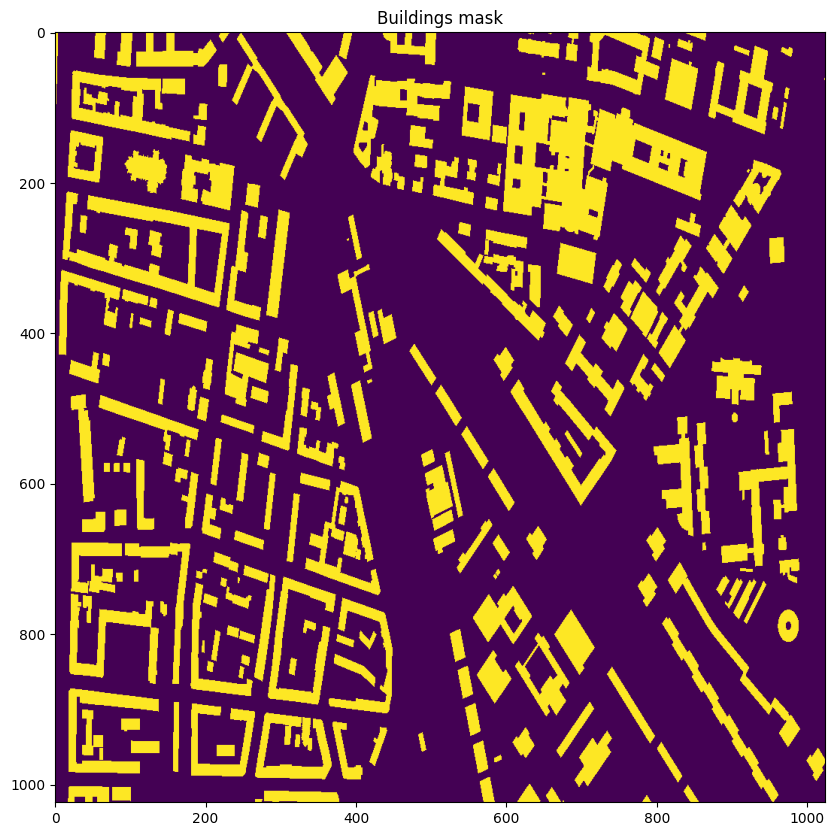

In [11]:
# filter out only buildings
buildings_gdf = leipzig_urban_gdf[leipzig_urban_gdf["building"].notnull()]

# Create raster
transform = from_bounds(minx, miny, maxx, maxy, 1024, 1024)
mask = geometry_mask(buildings_gdf.geometry, transform=transform, invert=True, out_shape=(1024, 1024))

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(mask, ax=ax)
ax.set_title("Buildings mask")
plt.show()

In [ ]:
geom = [shapes for shapes in buildings_gdf.geometry]

# 

### Get highest temperatures for last 5 years from DWD

### Get LST Data from Sentinel-3

### Get Skysat images from Planet Labs

### Create Cube using Xarray